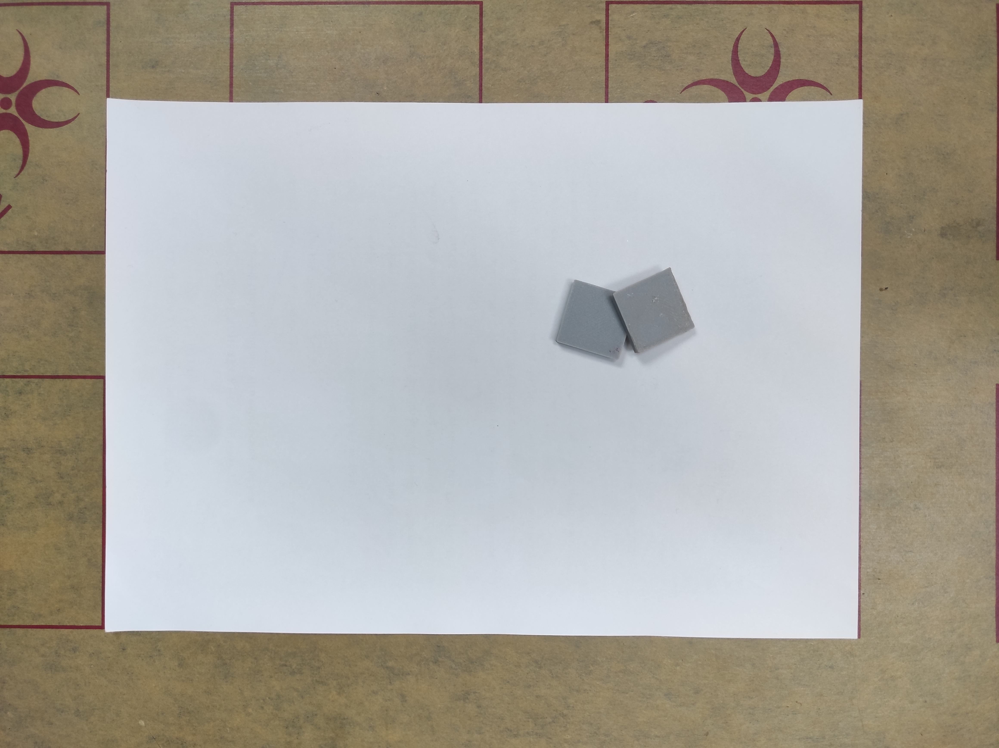

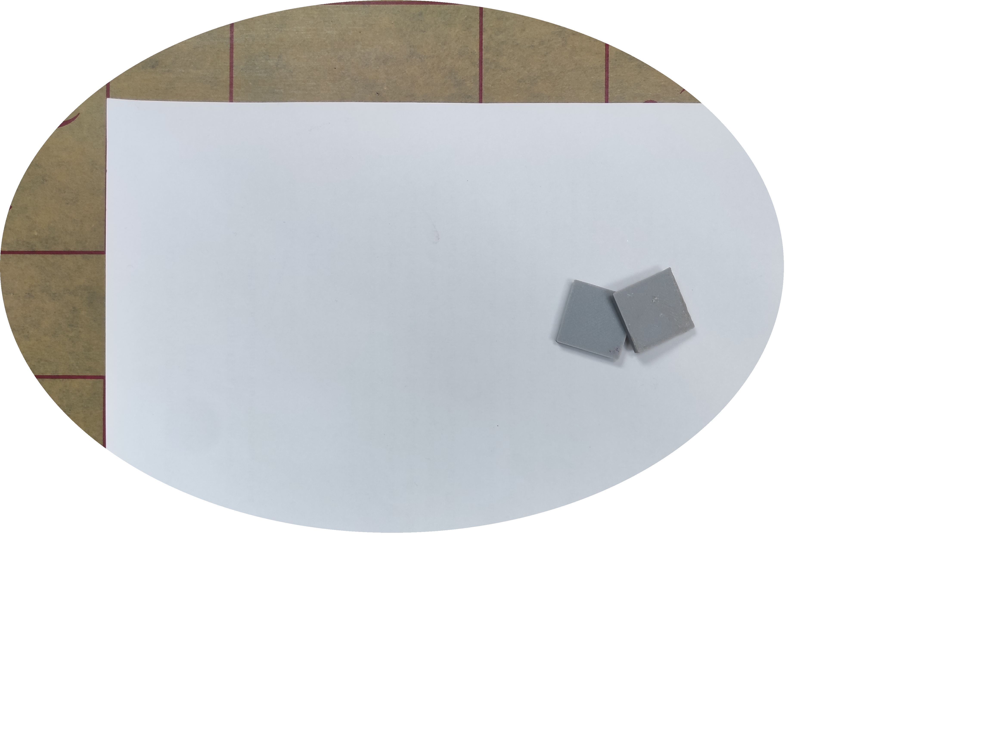

In [5]:

import numpy as np
from PIL import Image, ImageDraw
  
img=Image.open("E:\\Project_GS_X\\data_Tan\\IMG_20221222_161232.jpg")
display(img)
  
height,width = img.size
lum_img = Image.new('L', [height,width] , 0)
  
draw = ImageDraw.Draw(lum_img)
draw.pieslice([(0,0), (height-1000,width-1000)], 0, 360, 
              fill = 255, outline = "white")

lum_img_arr =np.array(lum_img)
#display(Image.fromarray(lum_img_arr))

img_arr =np.array(img)
final_img_arr = np.dstack((img_arr,lum_img_arr))

display(Image.fromarray(final_img_arr))

In [8]:
def lowPassFiltering(img,size):#Transfer parameters are Fourier transform spectrogram and filter size
    h , w = img.shape[0:2]
    h1,w1 = int(h/2), int(w/2)
    img_ = img.copy()
    for i in range(h):
      for j in range(w):
        D = int(pow((pow((i-h1),2)+pow((j-w1),2)),0.5))
        if D > size/2:
          img_[i,j] = 0
        j += 1
      i +=1
    return img_

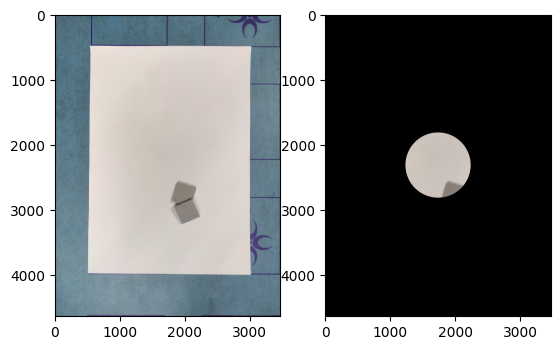

In [11]:
import cv2 as cv
import matplotlib.pyplot as plt

img = cv.imread("E:\\Project_GS_X\\data_Tan\\IMG_20221222_161232.jpg")
img_ = lowPassFiltering(img,1000)
plt.subplot(1,2,1)
plt.imshow(img)
plt.subplot(1,2,2)
plt.imshow(img_)